# Crossings with different speeds

In this notebook, we train a policy to navigate at a target speed configurable at runtime.

We look at the "CrossTorus" scenario, a squared periodic "plaza", where agents coming from four different streams cross.

## Uniform target speed

Let us start with the simpler scenario in which all agents move at the *same* target speed:

In [1]:
from navground import core, sim

hl_uniform_scenario = sim.load_scenario("""
type: CrossTorus
agent_margin: 0.1
side: 2
groups:
  -
    type: thymio
    number: 10
    radius: 0.1
    control_period: 0.1
    speed_tolerance: 0.02
    color: [red, green, blue, yellow]
    kinematics:
      type: 2WDiff
      wheel_axis: 0.094
      max_speed: 0.12
    behavior:
      type: HL
      horizon: 5.0
      tau: 0.25
      eta: 0.5
      safety_margin: 0.1
      barrier_angle: 1.0
    state_estimation:
      type: Bounded
      range: 1.0
""")

Let us check how `HL` agents perform. Agents are colored by the direction they are aiming to.

In [2]:
from navground.sim.ui.video import display_video_from_run, display_video, record_video_from_run, record_video

world = sim.World()
hl_uniform_scenario.init_world(world)
display_video(world, time_step=0.1, duration=60.0, factor=5, display_width=400)

In [3]:
# record_video(f'unif_speed_hl.mp4', world, time_step=0.1, duration=240.0, factor=5)

Let us train a RL policy (on a multi-agent enviroment) on the same setup.
Contrary to the "Cross" scenario in other tutorials, for this scenario agents don't have a targer point,
just a target direction. Therefore, we do not pass it in the observations, e.g. 
```python
observation_config = ObservationConfig(include_target_distance=False, ...)
```

In [4]:
import pandas as pd
from stable_baselines3.common.vec_env import VecMonitor

from navground_learning import ControlActionConfig, ObservationConfig
from navground_learning.env.pz import shared_parallel_env
from navground_learning.env.pz_utils import make_venv
from navground_learning.reward import SocialReward

uniform_scenario = sim.load_scenario("""
type: CrossTorus
agent_margin: 0.1
side: 2
groups:
  -
    type: thymio
    number: 10
    radius: 0.1
    control_period: 0.1
    speed_tolerance: 0.02
    color: [red, green, blue, yellow]
    kinematics:
      type: 2WDiff
      wheel_axis: 0.094
      max_speed: 0.12
    behavior:
      type: ''
""")

sensor = sim.load_state_estimation("""
type: Discs
number: 5
range: 1.0
max_speed: 0.12
max_radius: 0
""")

uniform_reward = SocialReward(safety_margin=0.1)
action_config = ControlActionConfig(max_acceleration=1.0, max_angular_acceleration=10.0, 
                                    use_acceleration_action=True)
observation_config = ObservationConfig(include_target_distance=False, include_target_direction=True,
                                       include_velocity=True, include_angular_speed=True, flat=True)
uniform_env = shared_parallel_env(scenario=uniform_scenario, agent_indices=None, sensor=sensor, action=action_config, 
                          observation=observation_config, reward=uniform_reward, 
                          time_step=0.1, max_duration=120, terminate_outside_bounds=False)
uniform_venv = VecMonitor(make_venv(uniform_env))

In [5]:
from stable_baselines3 import SAC
from stable_baselines3.common.logger import configure
from datetime import datetime as dt

timestamp = int(dt.now().timestamp())

uniform_speed_model = SAC("MlpPolicy", uniform_venv, policy_kwargs={'net_arch': [128, 128]})
uniform_speed_model.set_logger(configure(f'logs/CrossingWithSameSpeed/SAC_{timestamp}', ["csv"]))

In [6]:
uniform_speed_model.learn(total_timesteps=1_000_000, progress_bar=True, reset_num_timesteps=False)

Output()

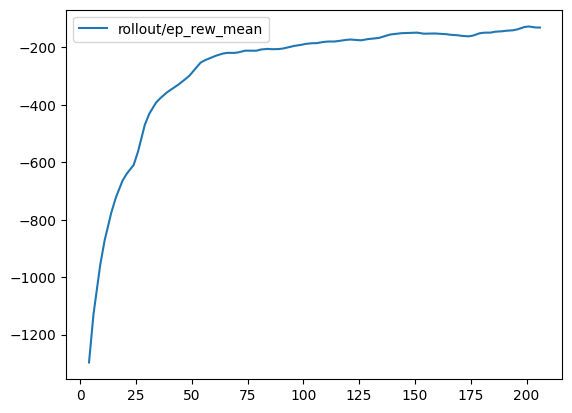

In [7]:
df = pd.read_csv(f'{uniform_speed_model.logger.get_dir()}/progress.csv')
df.rolling(window=5).mean().plot(y='rollout/ep_rew_mean');

As usual, we would like to check how the trained policy performs, with a video:

In [8]:
from navground_learning.evaluate import make_experiment_with_env

exp = make_experiment_with_env(uniform_env, policy=uniform_speed_model.policy)
exp.record_config.pose = True
exp.number_of_runs = 1
exp.steps = 2400
exp.run()
display_video_from_run(exp.runs[0], factor=5, relative_margin=0, display_width=400, display_shape=False)

In [9]:
# record_video_from_run(f'unif_speed_sac.mp4', exp.runs[0], factor=5, relative_margin=0, display_shape=False)

and by measuring the reward compared with `HL`

In [11]:
from navground_learning import WorldConfig
from navground_learning.evaluate import make_experiment
import numpy as np

def evaluate_expert(scenario, reward, runs=50) -> np.ndarray:
    exp = make_experiment(scenario=scenario, config=WorldConfig(reward=reward))
    exp.number_of_runs = runs
    exp.run()
    rs = np.asarray([run.get_record("reward") for run in exp.runs.values()])
    return np.sum(rs, axis=1).flatten()

HL reward : -71.96
SAC reward: -95.92


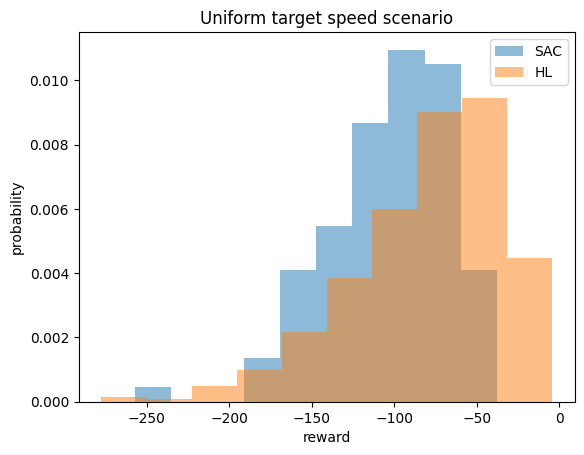

In [12]:
from stable_baselines3.common.evaluation import evaluate_policy
from matplotlib import pyplot as plt

uniform_speed_hl_rewards = evaluate_expert(hl_uniform_scenario, uniform_reward, runs=100)
uniform_speed_sac_rewards = np.asarray(evaluate_policy(uniform_speed_model.policy, uniform_venv, 100, 
                                                       return_episode_rewards=True)[0])
print(f'HL reward : {np.median(uniform_speed_hl_rewards):.2f}')
print(f'SAC reward: {np.median(uniform_speed_sac_rewards):.2f}')
plt.hist(uniform_speed_sac_rewards, bins=10, density=True, label="SAC", alpha=0.5);
plt.hist(uniform_speed_hl_rewards.flatten(), bins=10, density=True, label="HL", alpha=0.5);
plt.xlabel('reward')
plt.ylabel('probability');
plt.title('Uniform target speed scenario')
plt.legend();

In [13]:
uniform_speed_model.save(f"policies/CrossingWithSameSpeed/SAC_{timestamp}")

## Individual target speed

Let us move to the scenario in which agents should move at an individual target speed, which is randomly sampled at the beginning of the run and kept constant.
In order to set consistent target angular speeds, we add an initializer to the scenario that set the behavior's `optimal_angular_speed` to the maximal angular speed
achievable with a maximal linear wheel speed of optimal_speed`.

In [14]:
hl_individual_scenario = sim.load_scenario("""
type: CrossTorus
agent_margin: 0.1
side: 2
groups:
  -
    type: thymio
    number: 10
    radius: 0.1
    control_period: 0.1
    speed_tolerance: 0.02
    color: [red, green, blue, yellow]
    kinematics:
      type: 2WDiff
      wheel_axis: 0.094
      max_speed: 0.12
    behavior:
      type: HL
      horizon: 5.0
      tau: 0.25
      eta: 0.5
      safety_margin: 0.1
      barrier_angle: 0.78
      optimal_speed:
        sampler: uniform
        from: 0.03
        to: 0.12
    state_estimation:
      type: Bounded
      range: 1.0
""")

def set_optimal_angular_speed(world: sim.World) -> None:
    for agent in world.agents:
        agent.behavior.optimal_angular_speed = 2 * agent.behavior.optimal_speed / agent.kinematics.axis

hl_individual_scenario.add_init(set_optimal_angular_speed)

Again, let us check how the `HL` agents perform. Agents are now colored by their `optimal_speed` (`optimal_speed=0`: red, `optimal_speed=0.12`: green). 

In [15]:
from navground.sim.ui import svg_color

def decorate(agent):
    f = agent.behavior.optimal_speed / 0.12
    return {'fill': svg_color(1 - f, f, 0.1)}

world = sim.World()
hl_individual_scenario.init_world(world)
display_video(world, time_step=0.1, duration=60.0, factor=5, display_width=400, decorate=decorate)

In [16]:
# record_video(f'ind_speed_hl.mp4', world, time_step=0.1, duration=240.0, factor=5, decorate=decorate)

In order to make the policy respect the target speed, we add a term in the reward that penalizes excessive speeds: 

In [17]:
import dataclasses as dc
from navground_learning.reward import Reward
from typing import Any

@dc.dataclass
class CTReward(Reward):
    alpha: float = 1.0
    beta: float = 1.0
    critical_safety_margin: float = 0.0
    safety_margin: float | None = None
    
    def __call__(self, agent: sim.Agent, world: sim.World,
                 time_step: float) -> float:
        if self.safety_margin is None:
            if agent.behavior:
                sm = agent.behavior.safety_margin
            else:
                sm = 0
        else:
            sm = self.safety_margin
        if sm > 0:
            max_violation = max(0, sm - self.critical_safety_margin)
            sv = world.compute_safety_violation(agent, sm)
            if sv == 0:
                r = 0.0
            elif sv > max_violation:
                r = -self.alpha
            else:
                r = -self.alpha * sv / max_violation
        else:
            r = 0
        if agent.behavior:
            e = agent.behavior.get_target_direction(core.Frame.absolute)
            target_speed = agent.behavior.get_target_speed()
            efficacy = np.dot(agent.velocity, e) / target_speed
            # clamped to one
            r += min(efficacy, 1) - 1
            speed = np.linalg.norm(agent.velocity)
            angular_speed = abs(agent.angular_speed)
            target_angular_speed = agent.behavior.get_target_angular_speed()
            if speed > target_speed:
                r += self.beta * (target_speed - speed) / target_speed

            if angular_speed > target_angular_speed:
                r += self.beta * (target_angular_speed - angular_speed) / target_angular_speed
        return r

    @property
    def asdict(self) -> dict[str, Any]:
        return dc.asdict(self)

We are ready to define a new enviroment. This time, we need to pass the target speed in the observations too!

In [19]:
scenario = sim.load_scenario("""
type: CrossTorus
agent_margin: 0.1
side: 2
groups:
  -
    type: thymio
    number: 10
    radius: 0.1
    control_period: 0.1
    speed_tolerance: 0.02
    color: [red, green, blue, yellow]
    kinematics:
      type: 2WDiff
      wheel_axis: 0.094
      max_speed: 0.12
    behavior:
      type: ''
      optimal_speed:
        sampler: uniform
        from: 0.03
        to: 0.12 
""")

sensor = sim.load_state_estimation("""
type: Discs
number: 5
range: 1.0
max_speed: 0.12
max_radius: 0
""")

individual_reward = CTReward(safety_margin=0.1, alpha=2.0, beta=2.0)
action_config = ControlActionConfig(max_acceleration=1.0, max_angular_acceleration=10.0, 
                                    use_acceleration_action=True)
observation_config = ObservationConfig(include_target_distance=False, include_target_direction=True, 
                                       include_velocity=True, include_angular_speed=True, 
                                       flat=True, include_target_speed=True)
individual_env = shared_parallel_env(scenario=scenario, agent_indices=None, sensor=sensor, 
                                     action=action_config, observation=observation_config, reward=individual_reward, 
                                     time_step=0.1, max_duration=120, terminate_outside_bounds=False)
individual_venv = VecMonitor(make_venv(individual_env))

We keep the reset of the configuration like in the uniform case.

In [20]:
from stable_baselines3 import SAC
from stable_baselines3.common.logger import configure
from datetime import datetime as dt

timestamp = int(dt.now().timestamp())

individual_speed_model = SAC("MlpPolicy", individual_venv, policy_kwargs={'net_arch': [128, 128]})
individual_speed_model.set_logger(configure(f'logs/CrossingWithDifferentSpeed/SAC_{timestamp}', ["csv"]))

This model needs more examples to train well

In [21]:
individual_speed_model.learn(total_timesteps=3_000_000, progress_bar=True, reset_num_timesteps=False)

Output()

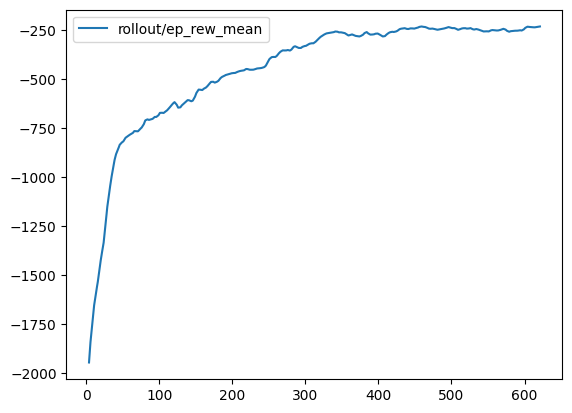

In [22]:
df = pd.read_csv(f'{individual_speed_model.logger.get_dir()}/progress.csv')
df.rolling(window=5).mean().plot(y='rollout/ep_rew_mean');

Let's check the results.

In [23]:
exp = make_experiment_with_env(individual_env, policy=individual_speed_model.policy)
exp.record_config.pose = True
exp.number_of_runs = 1
exp.steps = 2400
exp.run()
display_video_from_run(exp.runs[0], factor=5, relative_margin=0, display_width=400, display_shape=False, decorate=decorate)

In [24]:
# record_video_from_run(f'ind_speed_sac.mp4', exp.runs[0], factor=5, relative_margin=0, display_shape=False, decorate=decorate)

HL reward : -98.01
SAC reward: -226.02


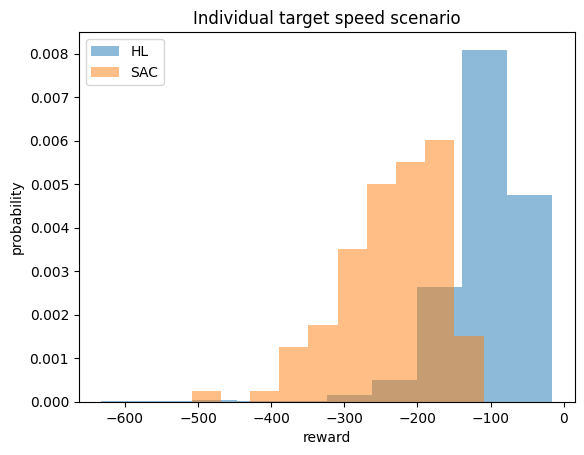

In [27]:
individual_speed_hl_rewards = evaluate_expert(hl_individual_scenario, individual_reward, runs=100)
individual_speed_sac_rewards = np.asarray(evaluate_policy(individual_speed_model.policy, individual_venv, 100, 
                                                          return_episode_rewards=True)[0])
print(f'HL reward : {np.median(individual_speed_hl_rewards):.2f}')
print(f'SAC reward: {np.median(individual_speed_sac_rewards):.2f}')
plt.hist(individual_speed_hl_rewards.flatten(), bins=10, density=True, label="HL", alpha=0.5);
plt.hist(individual_speed_sac_rewards, bins=10, density=True, label="SAC", alpha=0.5);
plt.xlabel('reward')
plt.ylabel('probability');
plt.title('Individual target speed scenario')
plt.legend();

In [28]:
individual_speed_model.save(f"policies/CrossingWithDifferentSpeed/SAC_{timestamp}")

It seems to work well ... but is it really respecting the target speed? What if we change it at runtime. 
We test this qualitatively by running an experiment where we manually modulate the target speed of all agents in time.
For this, we introduce a [sinusoidal] modulation of the behavior optimal speed:

In [29]:
from typing import Callable

class VaryOptimalSpeed(core.BehaviorModulation):

    def __init__(self, get_time: Callable[[], float]):
        super().__init__()
        self.get_time = get_time
        
    def pre(self, behavior: core.Behavior, time_step: float) -> None:
        behavior.optimal_speed = (np.sin(self.get_time() / 10) + 1) * 0.06
        behavior.optimal_angular_speed = 2 * behavior.optimal_speed / behavior.kinematics.axis

def add_speed_modulation(world: sim.World) -> None:
    for agent in world.agents:
        mod = VaryOptimalSpeed(lambda: world.time)
        agent.behavior.add_modulation(mod)
        agent.behavior._mod = mod

and add it to all agents

In [31]:
scenario = sim.load_scenario("""
type: CrossTorus
agent_margin: 0.1
side: 2
groups:
  -
    type: thymio
    number: 10
    radius: 0.1
    control_period: 0.1
    speed_tolerance: 0.02
    color: [red, green, blue, yellow]
    kinematics:
      type: 2WDiff
      wheel_axis: 0.094
      max_speed: 0.12
    behavior:
      type: ''
""")

test_env = shared_parallel_env(scenario=scenario, agent_indices=None, sensor=sensor, 
                               action=action_config, observation=observation_config, reward=individual_reward, 
                               time_step=0.1, max_duration=120, terminate_outside_bounds=False)

world = sim.World()
exp = make_experiment_with_env(test_env, policy=individual_speed_model.policy)
exp.scenario.init_world(world)
add_speed_modulation(world)

In [32]:
display_video(world, time_step=0.1, duration=120, factor=5, relative_margin=0, 
              display_width=400, display_shape=True, decorate=decorate)

In [ ]:
# record_video(f'test_mod.mp4', world, time_step=0.1, duration=120, factor=5, relative_margin=0, 
#              display_shape=True, decorate=decorate)